# Figures of MeteoScape TC Meari

## Environment

In [1]:
import sys
sys.path.insert(0,"../.")
import meteoscape
import anndata
import pandas as pd
import numpy as np
import scvelo as scv
import scipy
import h5py
import hdf5plugin
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.cm
import matplotlib.colors
import matplotlib.animation as anm
from matplotlib import patheffects as PathEffects
matplotlib.rcParams['figure.dpi'] = 300
DPI = 300
FONTSIZE = 60

## Read data and define keys

In [2]:
adata_std=anndata.read_h5ad("adata.Midpoints.KNN.HD.h5ad")
basis="std"
vkey="velocity"
potential_key="potential"
rotation_key="rotation"
cluster_key="clusters"
basis_key="X_%s" % basis
data_pos=adata_std.obsm[basis_key]
pot_vkey_="%s_%s" % (potential_key, vkey)
rot_vkey_="%s_%s" % (rotation_key, vkey)
HD_rate = 0.0

## Midpoints and clusters

saving figure to file figures/Clusters.png


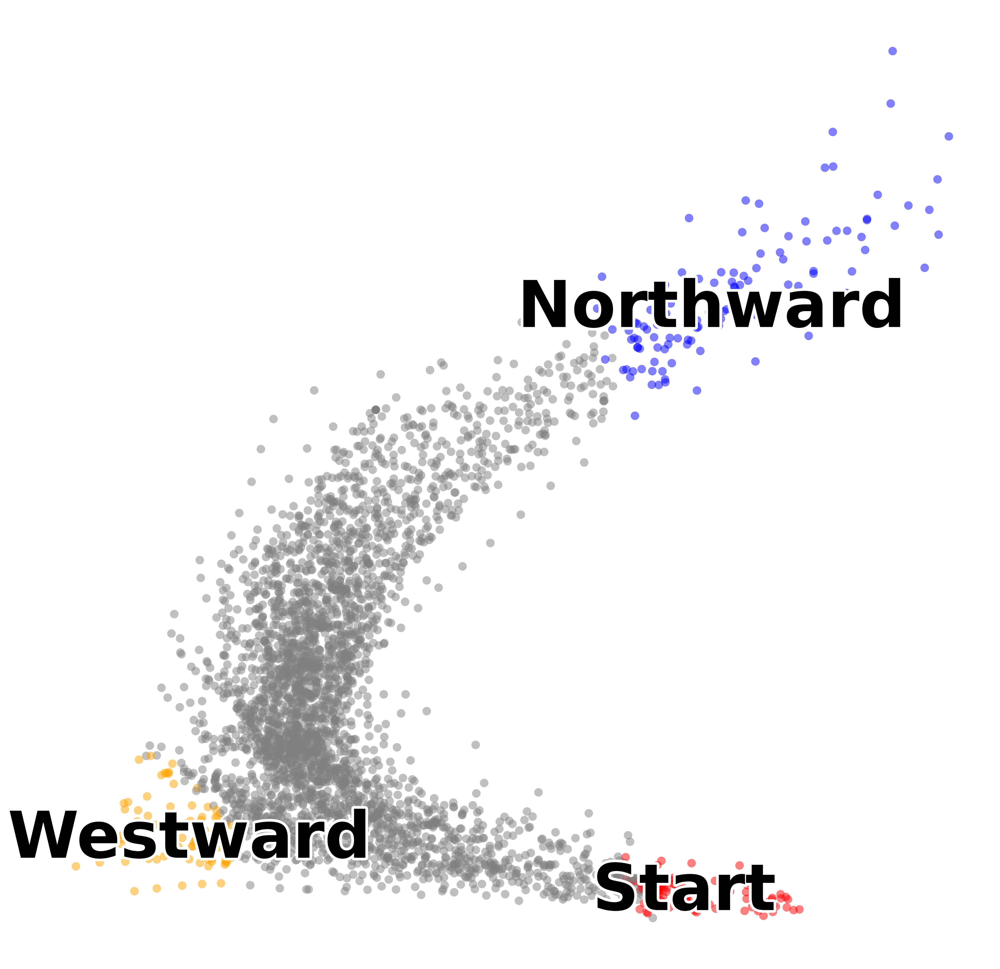

In [3]:
scv.pl.scatter(
    adata_std, 
    basis=basis,
    title="",
    palette=['grey','blue','red','orange'],
    fontsize=40,
    alpha=0.5,
    legend_loc='on data',
    legend_fontsize=FONTSIZE,
    legend_fontoutline=5,
    colorbar=False,
    size=250,
    figsize=(16, 16),
    add_margin=0.05,
    dpi=DPI,
    save="figures/Clusters.png"
)

## Midpoints and velocities

saving figure to file figures/Points_Velocities.png


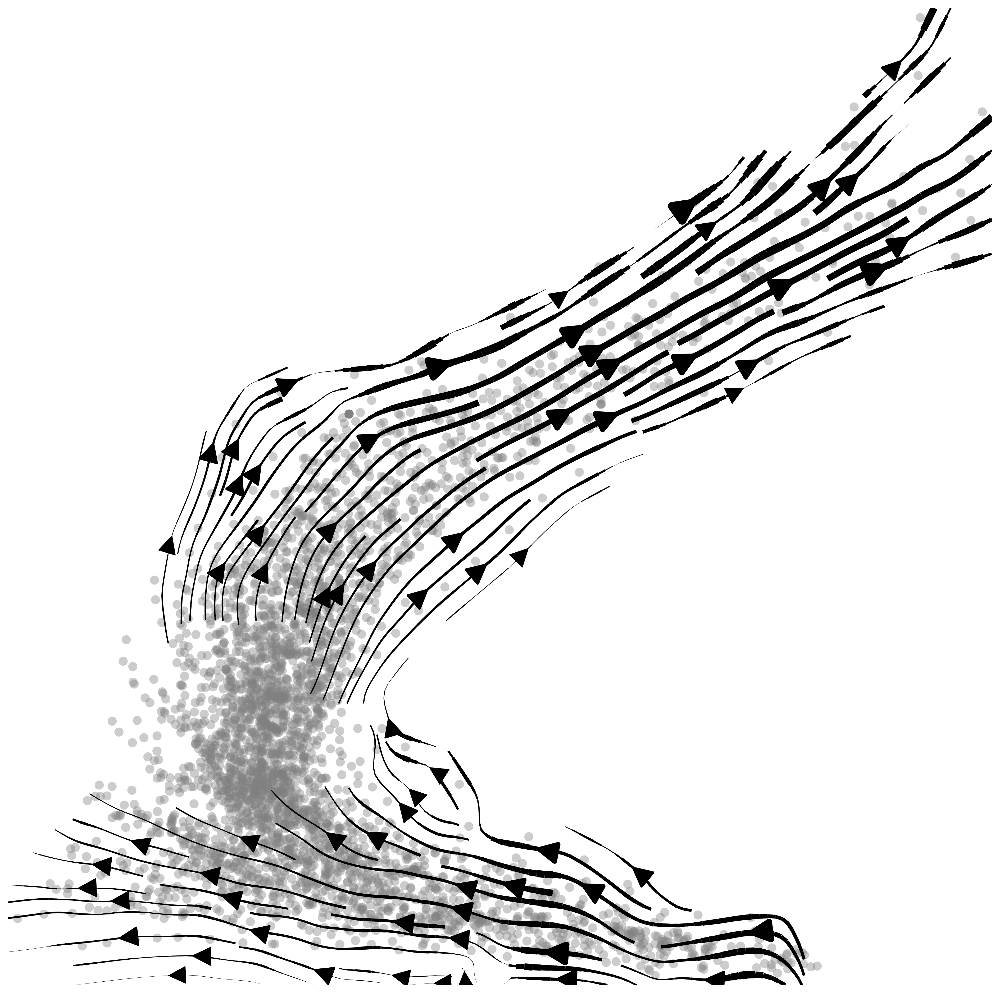

In [4]:
scv.pl.velocity_embedding_stream(
    adata_std, 
    basis=basis, 
    vkey=vkey, 
    title="",
    density=(4, 2), 
    alpha=0.4,
    fontsize=40,
    legend_fontsize=0,
    min_mass=1,
    arrow_size=4,
    linewidth=4,
    colorbar=False,
    color="grey",
    figsize=(16, 16),
    add_margin=0.00,
    dpi=DPI,
    save="figures/Points_Velocities.png"
)

## Potential flow

saving figure to file figures/Potential_Flow.png


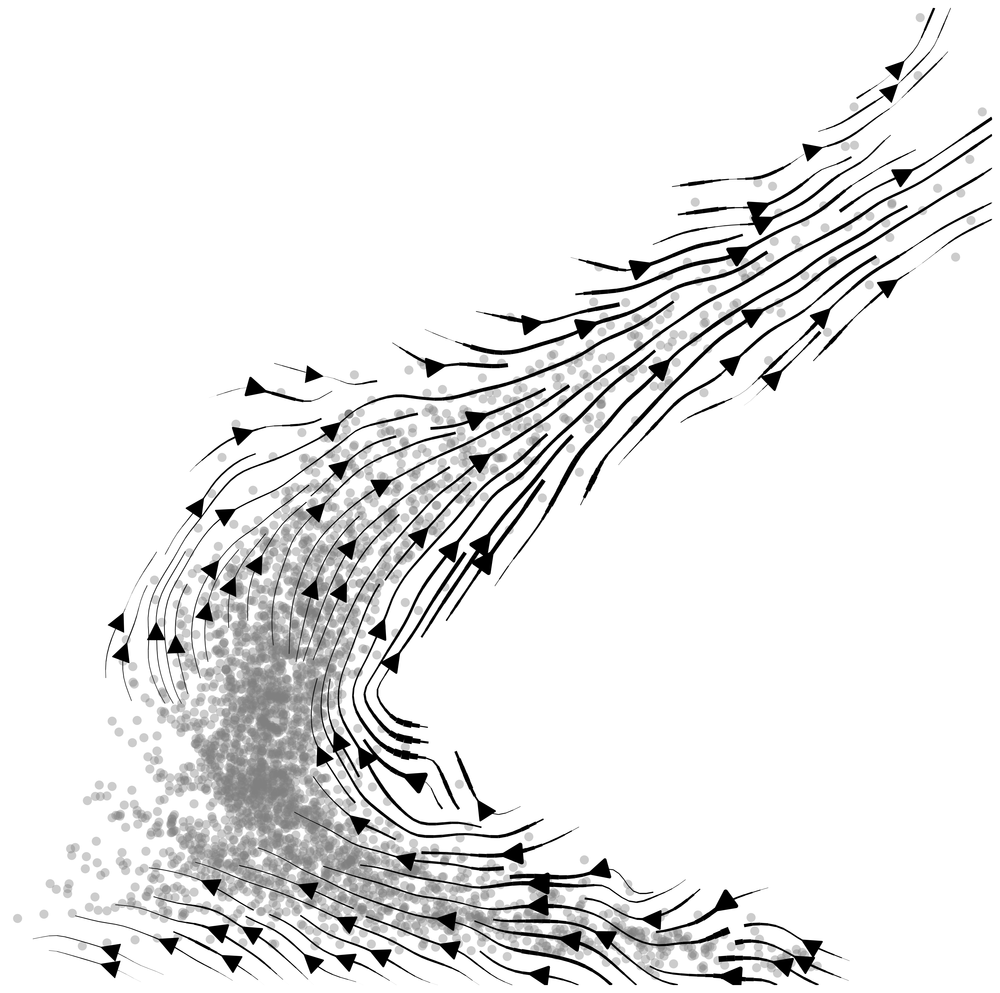

In [5]:
scv.pl.velocity_embedding_stream(
    adata_std, 
    basis=basis, 
    vkey=pot_vkey_, 
    title="",
    density=(4, 2), 
    alpha=0.4,
    fontsize=40,
    legend_fontsize=0,
    min_mass=1,
    arrow_size=4,
    linewidth=4,
    colorbar=False,
    color="grey",
    figsize=(16, 16),
    add_margin=0.00,
    dpi=DPI,
    save="figures/Potential_Flow.png"
)

## Rotational flow

saving figure to file figures/Rotational_Flow.png


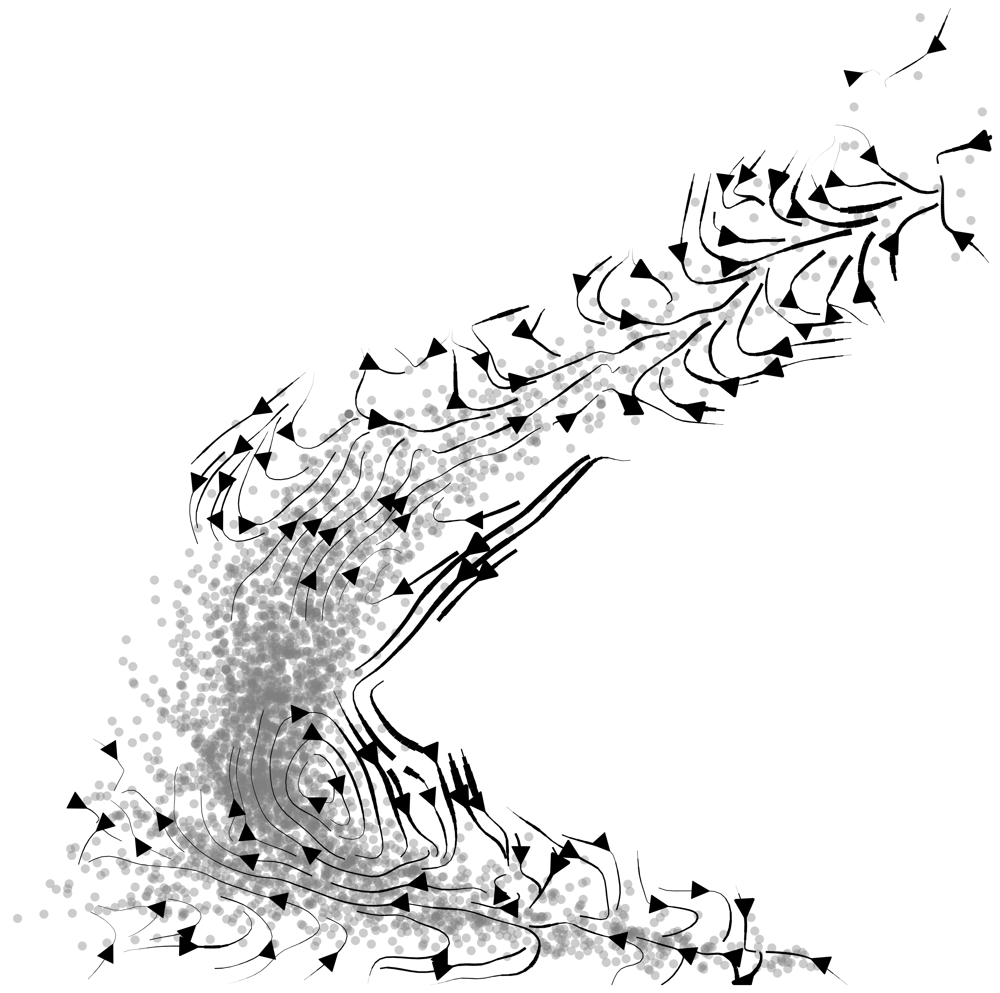

In [6]:
scv.pl.velocity_embedding_stream(
    adata_std, 
    basis=basis, 
    vkey=rot_vkey_, 
    title="",
    density=(4, 2), 
    alpha=0.4,
    fontsize=40,
    legend_fontsize=0,
    min_mass=1,
    arrow_size=4,
    linewidth=4,
    colorbar=False,
    color="grey",
    figsize=(16, 16),
    add_margin=0.00,
    dpi=DPI,
    save="figures/Rotational_Flow.png"
)

In [7]:
contour_key="streamfunc"
cutedge_vol=None
cutedge_length=None
key_ = "%s_%s" % (contour_key, basis)
pot_key_ = "%s_%s_%s" % (potential_key, contour_key, basis)
rot_key_ = "%s_%s_%s" % (rotation_key, contour_key, basis)
data_pos = adata_std.obsm[basis_key]
tri_ = meteoscape.create_graph(
    data_pos,
    cutedge_vol=cutedge_vol,
    cutedge_length=cutedge_length,
    return_type="triangles",
)[0]

contour_keys = [key_, pot_key_, rot_key_]
camps = [meteoscape.cmap_earth(adata_std.obs[key_]), "rainbow", "coolwarm"]
titles = ["", "", ""]

## Velocity orbit

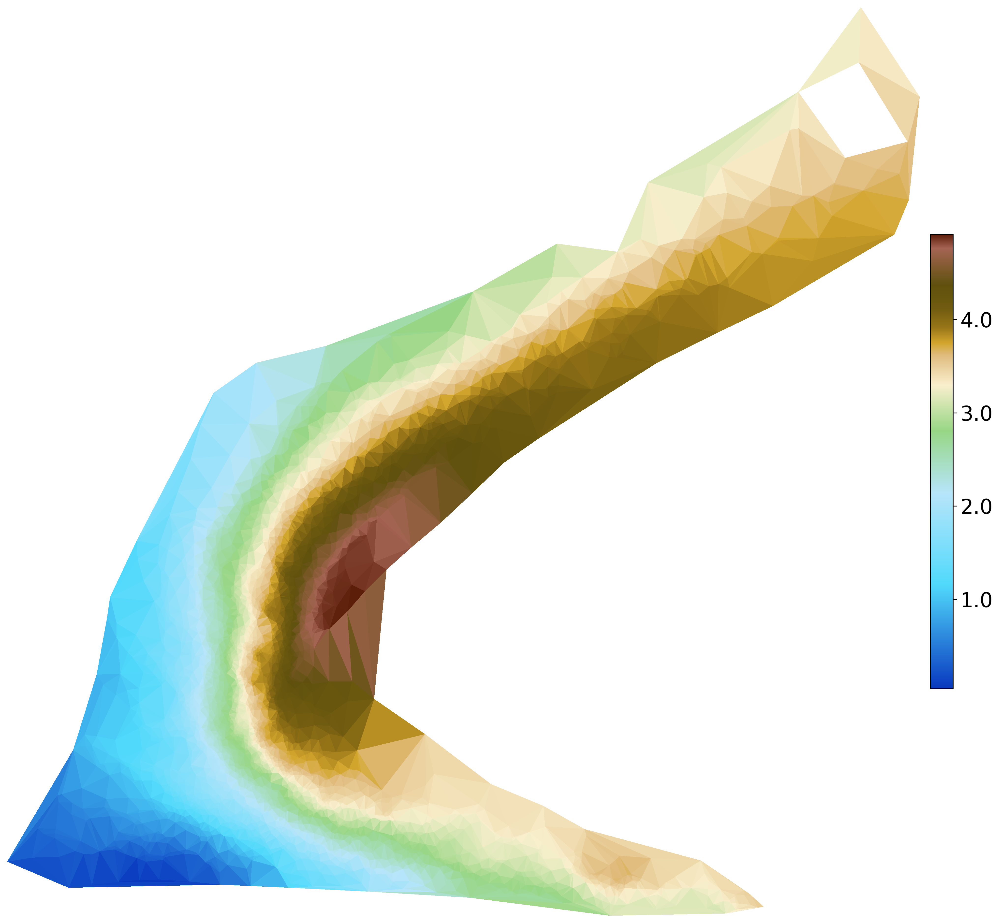

In [8]:
fig, ax = plt.subplots(figsize=(19, 16))

i=0
ax.axis("off")
ax.margins(0.05, 0.05)
ax.set_title(titles[i], fontsize=40)
sc = ax.tripcolor(tri_, adata_std.obs[contour_keys[i]], cmap=camps[i])
cbar=plt.colorbar(sc, aspect=20, pad=0.01, orientation="vertical", shrink=0.5, format="%0.1f")
cbar.ax.tick_params(labelsize=20) 
ax.tricontour(
    tri_,
    adata_std.obs[contour_keys[i]],
    lw=0.2,
    alpha=0.2,
    levels=0,
    zorder=1,
    colors="k",
    cmap=None,
    ls="-",
)
fig.savefig("figures/Velocity_Orbit.png", bbox_inches="tight", format="svg")

## Development orbit

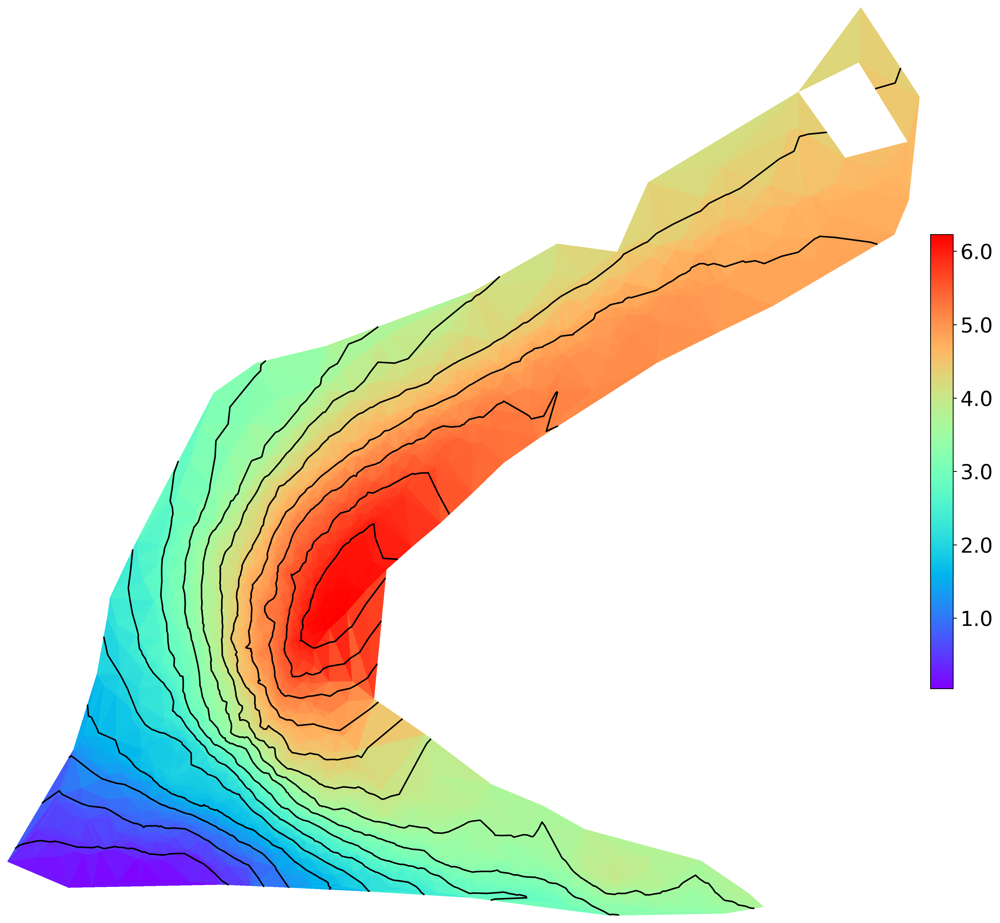

In [9]:
fig, ax = plt.subplots(figsize=(19, 16))

i=1
ax.axis("off")
ax.margins(0.05, 0.05)
ax.set_title(titles[i], fontsize=40)
sc = ax.tripcolor(tri_, adata_std.obs[contour_keys[i]], cmap=camps[i])
cbar=plt.colorbar(sc, aspect=20, pad=0.01, orientation="vertical", shrink=0.5, format="%0.1f")
#cbar.set_label(contour_keys[i], fontsize=30)
cbar.ax.tick_params(labelsize=20) 
ax.tricontour(
    tri_,
    adata_std.obs[contour_keys[i]],
    lw=0.2,
    alpha=0.2,
    levels=0,
    zorder=1,
    colors="k",
    cmap=None,
    ls="-",
)
ax.tricontour(
    tri_,
    adata_std.obs[contour_keys[i]],
    lw=1,
    alpha=1,
    # levels=[1,2,3,4,5,6,7,8,9,10],
    levels=15,
    zorder=1,
    colors="k",
    cmap=None,
    ls="-",
)
fig.savefig("figures/Development_Orbit.png", bbox_inches="tight", format="svg")

## Periodic orbit

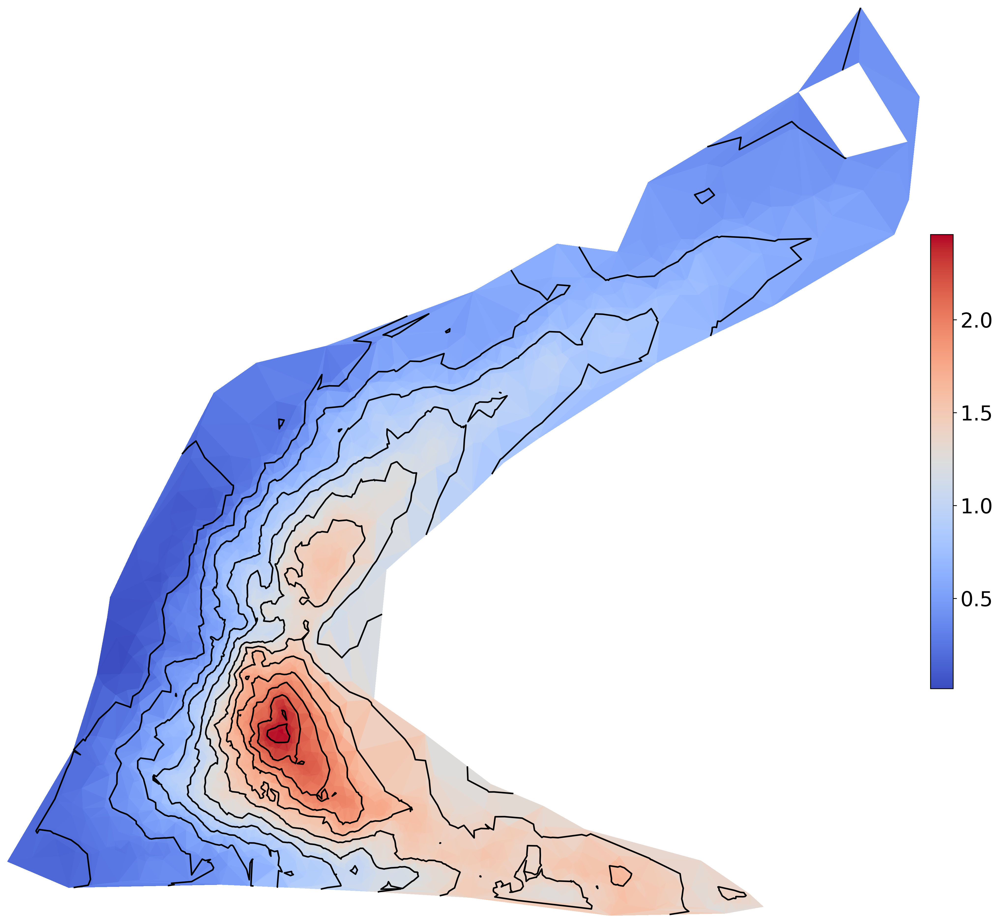

In [10]:
fig, ax = plt.subplots(figsize=(19, 16))

i=2
ax.axis("off")
ax.margins(0.05, 0.05)
ax.set_title(titles[i], fontsize=40)
sc = ax.tripcolor(tri_, adata_std.obs[contour_keys[i]], cmap=camps[i])
cbar=plt.colorbar(sc, aspect=20, pad=0.01, orientation="vertical", shrink=0.5, format="%0.1f")
#cbar.set_label(contour_keys[i], fontsize=30)
cbar.ax.tick_params(labelsize=20) 
ax.tricontour(
    tri_,
    adata_std.obs[contour_keys[i]],
    lw=0.2,
    alpha=0.2,
    levels=0,
    zorder=1,
    colors="k",
    cmap=None,
    ls="-",
)
ax.tricontour(
    tri_,
    adata_std.obs[contour_keys[i]],
    lw=1,
    alpha=1,
    # levels=[0.2, 0.4, 0.6, 0.8, 1.0, 1.2, 1.4, 1.6],
    levels=15,
    zorder=1,
    colors="k",
    cmap=None,
    ls="-",
)
fig.savefig("figures/Periodic_Orbit.png", bbox_inches="tight", format="svg")

In [11]:
basis_key = "X_%s" % basis
color_key = "potential"

data_pos = adata_std.obsm[basis_key]
tri_ = meteoscape.create_graph(
    data_pos,
    cutedge_vol=cutedge_vol,
    cutedge_length=cutedge_length,
    return_type="triangles",
)[0]

cmaps = meteoscape.cmap_earth(adata_std.obs[color_key])
titles = ""

## Hodge potential

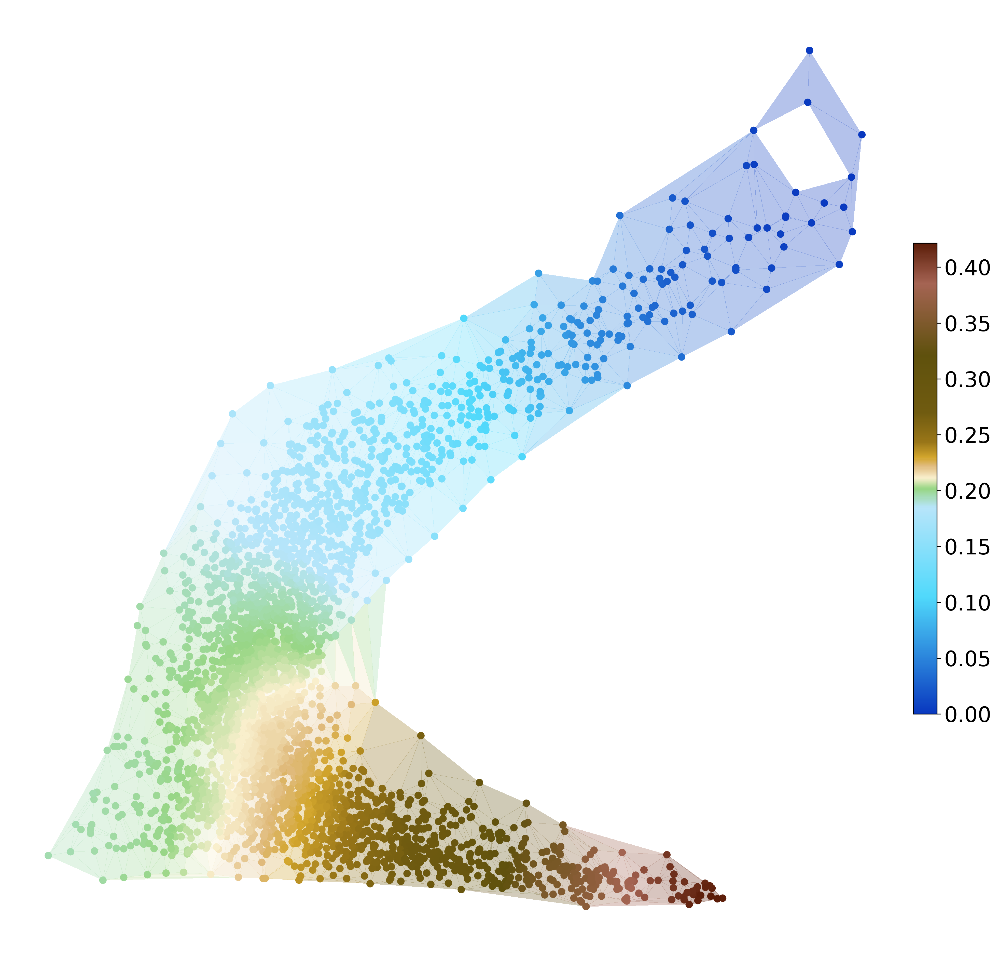

In [12]:
fig, ax = plt.subplots(figsize=(18, 16))
ax.axis("off")
ax.margins(0.05, 0.05)
ax.set_title(titles, fontsize=40)

sc = ax.scatter(
    data_pos[:, 0], data_pos[:, 1], c=adata_std.obs[color_key], zorder=10, cmap=cmaps
)
tri_ = meteoscape.create_graph(
    data_pos,
    cutedge_vol=cutedge_vol,
    cutedge_length=cutedge_length,
    return_type="triangles",
)[0]
ax.tripcolor(
    tri_, adata_std.obs[color_key], lw=0.5, zorder=0, alpha=0.3, cmap=cmaps
)
cbar=plt.colorbar(sc, aspect=20, pad=0.01, orientation="vertical", shrink=0.5)
#cbar.set_label(contour_keys[i], fontsize=30)
cbar.ax.tick_params(labelsize=20) 
fig.savefig("figures/Potential.png", bbox_inches="tight", format="svg")

## 3D visualization

In [13]:
meteoscape.view_3D(
    adata_std, 
    basis=basis,
    cluster_key=None
)

## Landscape

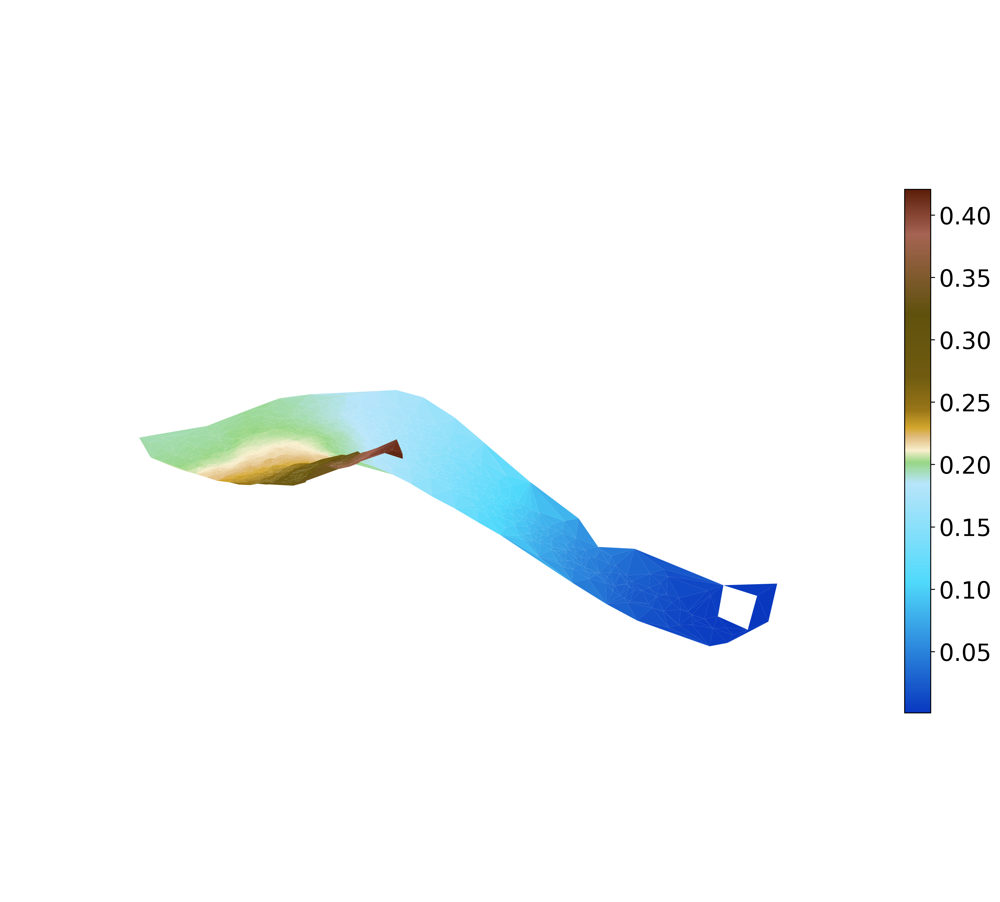

In [14]:
figsize=(16, 16)
elev=40
azim=-45
    
basis_key = "X_%s" % basis
data_pos = adata_std.obsm[basis_key]
cmaps = meteoscape.cmap_earth(adata_std.obs[potential_key])

tri_ = meteoscape.create_graph(
    data_pos,
    cutedge_vol=cutedge_vol,
    cutedge_length=cutedge_length,
    return_type="triangles",
)[0]
fig = plt.figure(figsize=figsize)
ax = fig.add_subplot(111, projection="3d")
plt.gca().patch.set_facecolor('white')
ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False
ax.grid(True)
ax.set_xticklabels([])
ax.set_yticklabels([])
ax.set_zticklabels([])
ax.w_xaxis.line.set_color((1.0, 1.0, 1.0, 0.0))
ax.w_yaxis.line.set_color((1.0, 1.0, 1.0, 0.0))
ax.w_zaxis.line.set_color((1.0, 1.0, 1.0, 0.0))
ax.w_xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
ax.w_yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
ax.w_zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
ax.set_xticks([]) 
ax.set_yticks([]) 
ax.set_zticks([])
cntr = ax.plot_trisurf(
    tri_, adata_std.obs[potential_key], cmap=cmaps, zorder=2
)
ax.set_box_aspect(aspect=(1, 1, 0.8))
ax.view_init(elev=elev, azim=azim)
cbar=plt.colorbar(cntr, aspect=20, pad=0.01, orientation="vertical", shrink=0.5)
cbar.ax.tick_params(labelsize=20) 
fig.savefig("figures/Landscape.png", bbox_inches="tight", format="svg")

## Optimal trajectories

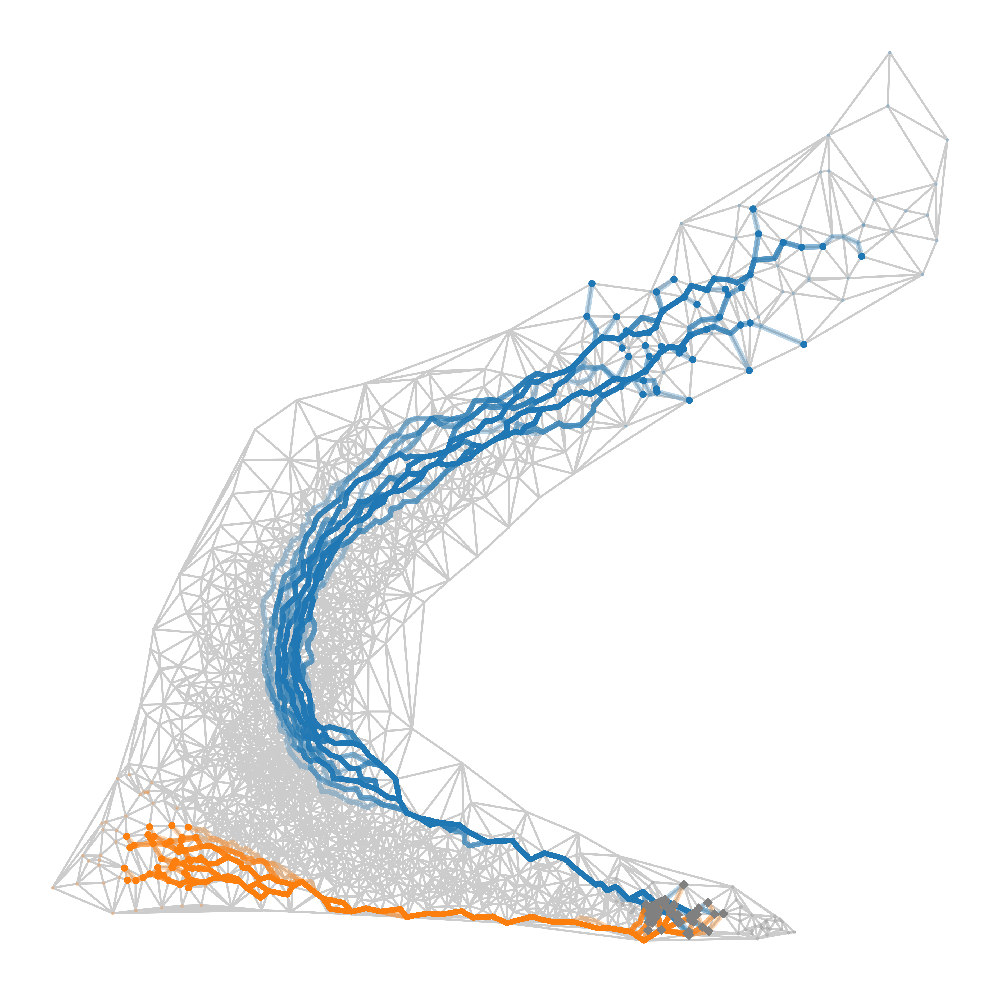

In [15]:
source_cluster = 'Start'
target_clusters = ['Northward', 'Westward']
meteoscape.view_trajectory(
    adata_std, 
    source_cluster, 
    target_clusters, 
    basis=basis, 
    weight_rate=0.90, 
    figsize=(16, 16),
    fontsize=24,
    alpha=0.4,
    title="",
    save_png=True,
    save_svg=False,
    save_dir="figures",
    save_filename="Trajectory"
)

## Dynamical clustering

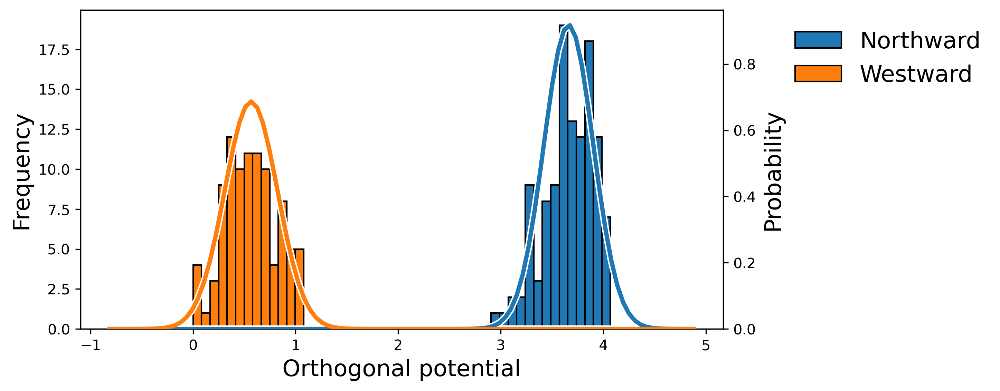

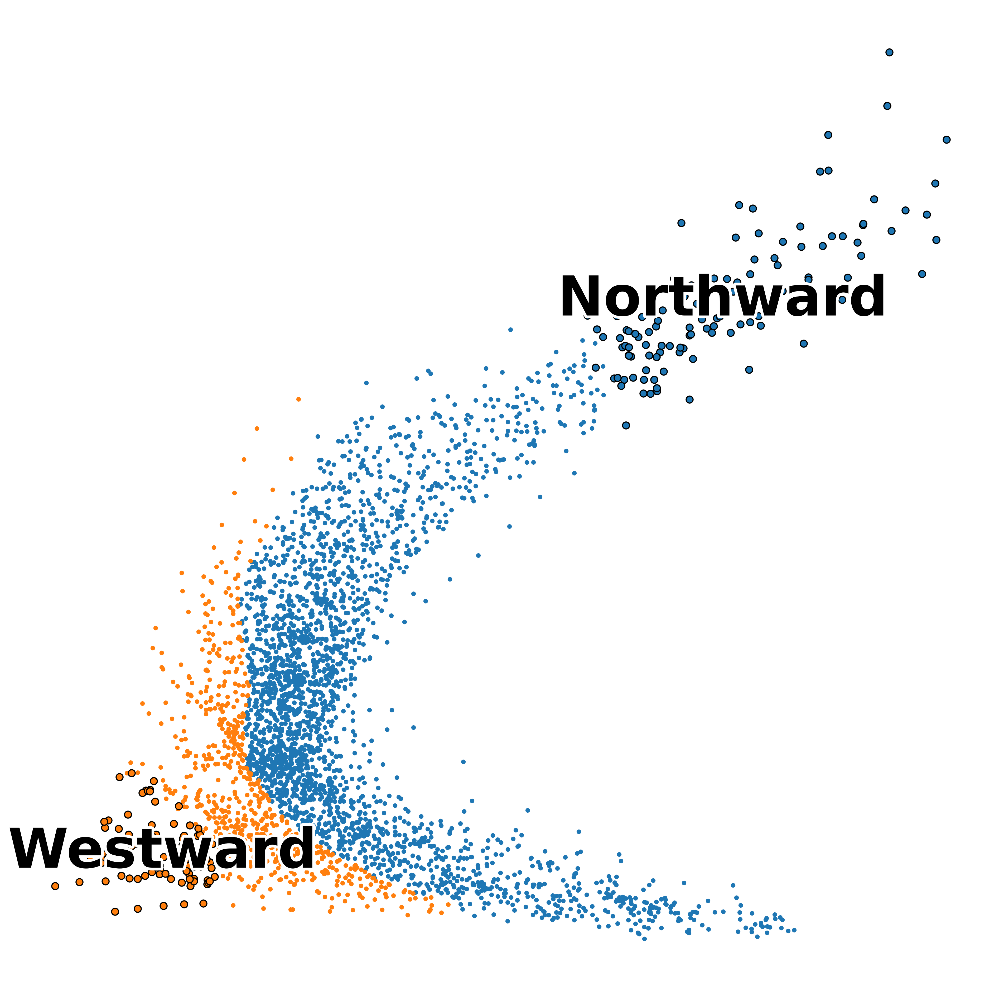

In [16]:
meteoscape.dynamical_clustering(
    adata_std,
    target_clusters, 
    basis=basis, 
    TO_prob = 1e-20,
    fsize=FONTSIZE-10,
    figsize=(16, 16),
    titles=["", ""],
    save_png=True,
    save_svg=False,
    save_dir="figures",
    save_filename="Dynamical_Clustering"
)